importing the libraries

In [4]:
import numpy as np 
import pandas as pd
import os
import seaborn as sns
# print(os.listdir("../input"))
import matplotlib.pyplot as plt
plt.style.use('ggplot')
import plotly.offline as py
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode
init_notebook_mode(connected=False)
from wordcloud import WordCloud
from geopy.geocoders import Nominatim
from folium.plugins import HeatMap
import folium
from tqdm import tqdm
import re
from tensorflow.keras.preprocessing.text import Tokenizer
from keras.preprocessing.sequence import pad_sequences
from keras.models import Sequential
from keras.layers import Dense, Embedding, LSTM, SpatialDropout1D
from sklearn.model_selection import train_test_split
from nltk import word_tokenize
from sklearn.feature_extraction.text import TfidfVectorizer
import gensim
from collections import Counter
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
import matplotlib.colors as mcolors
from sklearn.manifold import TSNE
from gensim.models import word2vec
import nltk

reading the zomato.csv file

In [5]:
df=pd.read_csv("zomato.csv")



In [6]:
# prints the number of rows and columns in a DataFrame
print("dataset contains {} rows and {} columns".format(df.shape[0],df.shape[1]))

dataset contains 51717 rows and 17 columns


In [7]:
# provides a concise summary of a DataFrame
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 51717 entries, 0 to 51716
Data columns (total 17 columns):
 #   Column                       Non-Null Count  Dtype 
---  ------                       --------------  ----- 
 0   url                          51717 non-null  object
 1   address                      51717 non-null  object
 2   name                         51717 non-null  object
 3   online_order                 51717 non-null  object
 4   book_table                   51717 non-null  object
 5   rate                         43942 non-null  object
 6   votes                        51717 non-null  int64 
 7   phone                        50509 non-null  object
 8   location                     51696 non-null  object
 9   rest_type                    51490 non-null  object
 10  dish_liked                   23639 non-null  object
 11  cuisines                     51672 non-null  object
 12  approx_cost(for two people)  51371 non-null  object
 13  reviews_list                 51

In [8]:
#  allows us to quickly view the first few rows of a DataFrame 
df.head()

,url,address,name,online_order,book_table,rate,votes,phone,location,rest_type,dish_liked,cuisines,approx_cost(for two people),reviews_list,menu_item,listed_in(type),listed_in(city)
0,https://www.zomato.com/bangalore/jalsa-banasha...,"942, 21st Main Road, 2nd Stage, Banashankari, ...",Jalsa,Yes,Yes,4.1/5,775,080 42297555\r\n+91 9743772233,Banashankari,Casual Dining,"Pasta, Lunch Buffet, Masala Papad, Paneer Laja...","North Indian, Mughlai, Chinese",800,"[('Rated 4.0', 'RATED\n A beautiful place to ...",[],Buffet,Banashankari
1,https://www.zomato.com/bangalore/spice-elephan...,"2nd Floor, 80 Feet Road, Near Big Bazaar, 6th ...",Spice Elephant,Yes,No,4.1/5,787,080 41714161,Banashankari,Casual Dining,"Momos, Lunch Buffet, Chocolate Nirvana, Thai G...","Chinese, North Indian, Thai",800,"[('Rated 4.0', 'RATED\n Had been here for din...",[],Buffet,Banashankari
2,https://www.zomato.com/SanchurroBangalore?cont...,"1112, Next to KIMS Medical College, 17th Cross...",San Churro Cafe,Yes,No,3.8/5,918,+91 9663487993,Banashankari,"Cafe, Casual Dining","Churros, Cannelloni, Minestrone Soup, Hot Choc...","Cafe, Mexican, Italian",800,"[('Rated 3.0', ""RATED\n Ambience is not that ...",[],Buffet,Banashankari
3,https://www.zomato.com/bangalore/addhuri-udupi...,"1st Floor, Annakuteera, 3rd Stage, Banashankar...",Addhuri Udupi Bhojana,No,No,3.7/5,88,+91 9620009302,Banashankari,Quick Bites,Masala Dosa,"South Indian, North Indian",300,"[('Rated 4.0', ""RATED\n Great food and proper...",[],Buffet,Banashankari
4,https://www.zomato.com/bangalore/grand-village...,"10, 3rd Floor, Lakshmi Associates, Gandhi Baza...",Grand Village,No,No,3.8/5,166,+91 8026612447\r\n+91 9901210005,Basavanagudi,Casual Dining,"Panipuri, Gol Gappe","North Indian, Rajasthani",600,"[('Rated 4.0', 'RATED\n Very good restaurant ...",[],Buffet,Banashankari


C:\Users\MOULYA\AppData\Local\Temp\ipykernel_16496\1148325424.py:8: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




Text(0.5, 0, 'Number of outlets')

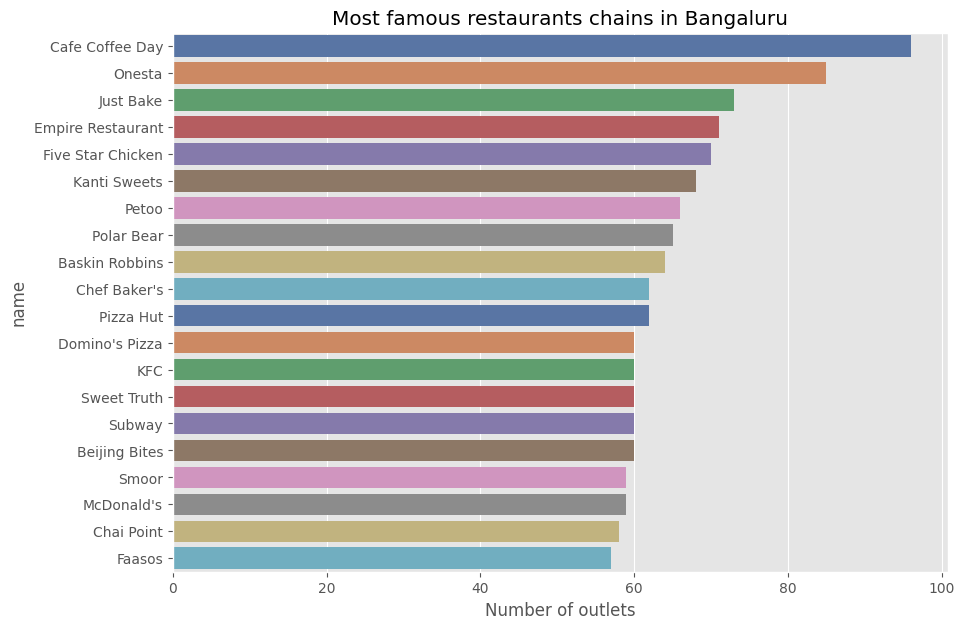

In [9]:
# Creates a new figure or plot with a specific size of width=10 inches and height=7 inches
plt.figure(figsize=(10,7))

#  Count the occurrences of each unique restaurant name in the 'name' column of the DataFrame and takes the top 20 most frequent restaurants and store the result in the 'chains' variable
chains=df['name'].value_counts()[:20]

# line creates a bar plot with restaurant counts on the x-axis, restaurant names on the y-axis, and uses the 'deep' color palette
sns.barplot(x=chains,y=chains.index,palette='deep')

# Sets the title for the plot
plt.title("Most famous restaurants chains in Bangaluru")

#  Sets the label for the x-axis
plt.xlabel("Number of outlets")

In [10]:
# its an offline plotting module, which allows to create plots that can be saved and viewed locally without an internet connection, and assigns it the pyo
import plotly.offline as pyo

In [11]:
# line counts the occurrences of each unique value in the 'online_order' column of a DataFrame called df and assigns the result to the variable x
# where it counts how many people accepted online orders and how many did not
x=df['online_order'].value_counts()

# line defines a list of colors to be used in the pie chart which is in hexadecimal color codes
colors = ['#FEBFB3', '#E1396C']

# line creates a pie chart, labeling each slice with its category,sizing it by its count, displaying the count on the slice, and customizing the slice colors and outline.
trace=go.Pie(labels=x.index,values=x,textinfo="value",
            marker=dict(colors=colors, 
                           line=dict(color='#000000', width=2)))

#  line sets up the overall look of the pie chart, giving it a title of "Accepting vs not accepting online orders" and defining its size to be 500 pixels wide and 500 pixels tall
layout=go.Layout(title="Accepting vs not accepting online orders",width=500,height=500)

# line creates a figure for the pie chart by including the pie chart data we prepared earlier and applying the layout settings we defined
fig=go.Figure(data=[trace],layout=layout)

#  line displays the pie chart using py.iplot
py.iplot(fig, filename='pie_chart_subplots')

In [12]:
# line counts how many restaurants offer table booking versus those that don't, and stores those numbers
x=df['book_table'].value_counts()

#  line creates a list of two colors green shades, in this case that will be used to color the slices of the pie chart
colors = ['#96D38C', '#D0F9B1']

# line generates the pie chart, labeling slices with booking options, sizing them by frequency, displaying counts, and customizing colors with black outlines
trace=go.Pie(labels=x.index,values=x,textinfo="value",
            marker=dict(colors=colors, 
                           line=dict(color='#000000', width=2)))

# line sets up the chart's appearance by setting the title to "Table booking" and specifying a 500x500 pixel size
layout=go.Layout(title="Table booking",width=500,height=500)

# line puts all the pieces together to create the complete pie chart and it combines the pie chart data (trace) and the layout settings into a Figure object.
fig=go.Figure(data=[trace],layout=layout)

# line displays the pie chart that we've created and uses py.iplot to show the chart and saves it with the filename 'pie_chart_subplots'
py.iplot(fig, filename='pie_chart_subplots')

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_16496\1289795442.py:9: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




<Axes: xlabel='rate', ylabel='Density'>

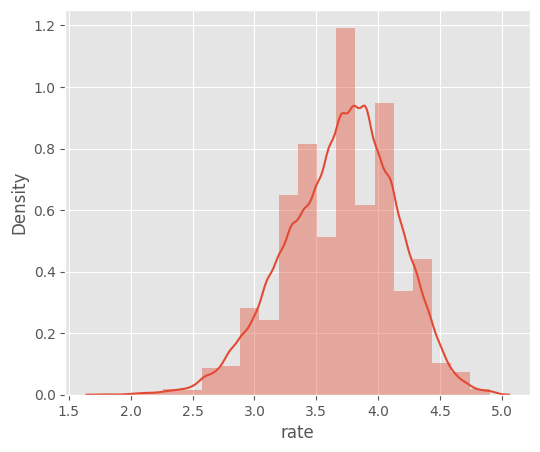

In [13]:
# ne initializes a Matplotlib figure with a specified width of 6 inches and a height of 5 inches and defining the plot's dimensions
plt.figure(figsize=(6,5))

# line cleans and transforms the 'rate' column in the DataFrame by removing missing values
# extracting and converting valid ratings from a string format '4.5/5' to floating-point numbers 
rating=df['rate'].dropna().apply(lambda x : float(x.split('/')[0]) if (len(x)>3)  else np.nan ).dropna()

# line creates a visual representation of the cleaned restaurant ratings
sns.distplot(rating,bins=20)

In [ ]:
# Create a new table called cost_dist containing only the 'rate', approx_cost(for two people) and also online_order columns from the original table df
cost_dist=df[['rate','approx_cost(for two people)','online_order']].dropna()

# each value in the 'rate' column of the cost_dist table, if the value has more than 3 characters it will splits the value at the '/', take the part before the '/', and it will convert it to a number
cost_dist['rate']=cost_dist['rate'].apply(lambda x: float(x.split('/')[0]) if len(x)>3 else 0)

# it cleans up the cost data by removing commas and converting the values to integers for easier numerical analysis
cost_dist['approx_cost(for two people)']=cost_dist['approx_cost(for two people)'].apply(lambda x: int(x.replace(',','')))


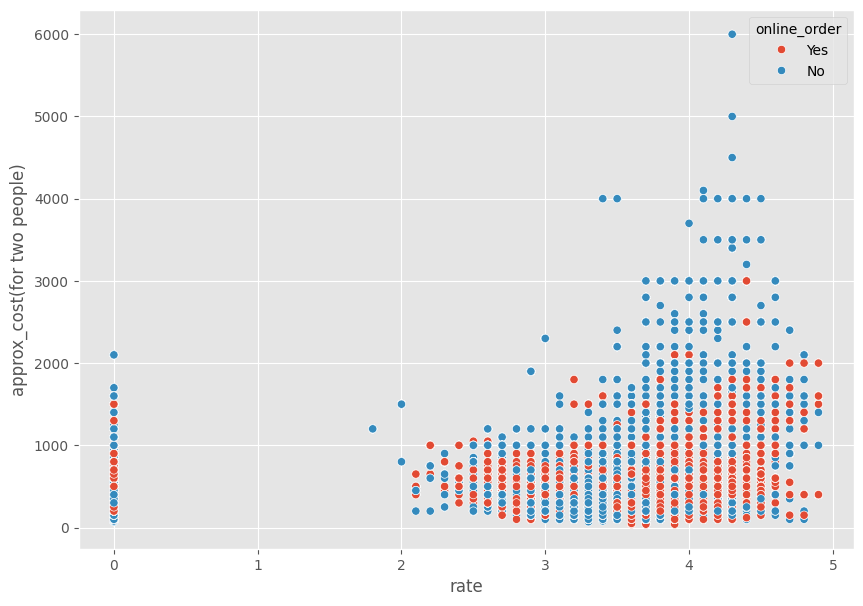

In [ ]:
# line creates a new figure for plotting with a width of width 10 inches and the height to 7 inches
plt.figure(figsize=(10,7))

# line creates a scatter plot showing the relationship between "rate" (x-axis) and "approx_cost(for two people)" (y-axis) from the DataFrame, with points colored based on "online_order" 
sns.scatterplot(x="rate",y='approx_cost(for two people)',hue='online_order',data=cost_dist)

# line displays the generated plot for the above scatter plot
plt.show()

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_16496\699008717.py:2: UserWarning:



`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751




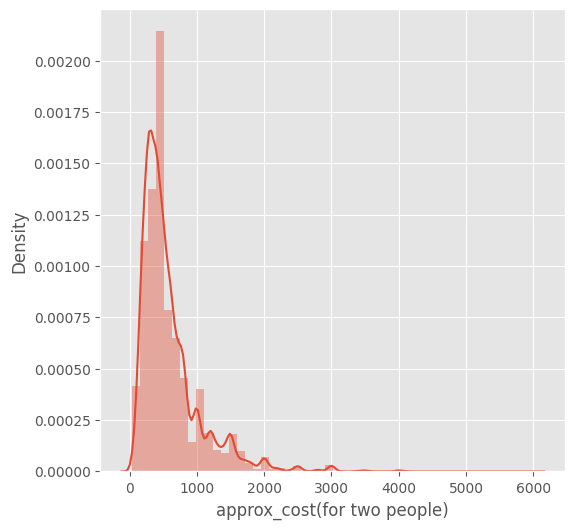

In [ ]:
# line creates a new figure for plotting with a width and height of 6 inches each this results in a square plot
plt.figure(figsize=(6,6))

# the Seaborn library is called to create a distribution plot and it takes data from the 'cost_dist' DataFrame, specifically the column labeled 'approx_cost(for two people)'
sns.distplot(cost_dist['approx_cost(for two people)'])

# this line displays the figure to see the distribution of costs for two people
plt.show()

In [17]:
votes_yes=df[df['online_order']=="Yes"]['votes']
trace0=go.Box(y=votes_yes,name="accepting online orders",
              marker = dict(
        color = 'rgb(214, 12, 140)',
    ))

votes_no=df[df['online_order']=="No"]['votes']
trace1=go.Box(y=votes_no,name="Not accepting online orders",
              marker = dict(
        color = 'rgb(0, 128, 128)',
    ))

layout = go.Layout(
    title = "Box Plots of votes",width=800,height=500
)

data=[trace0,trace1]
fig=go.Figure(data=data,layout=layout)
py.iplot(fig)


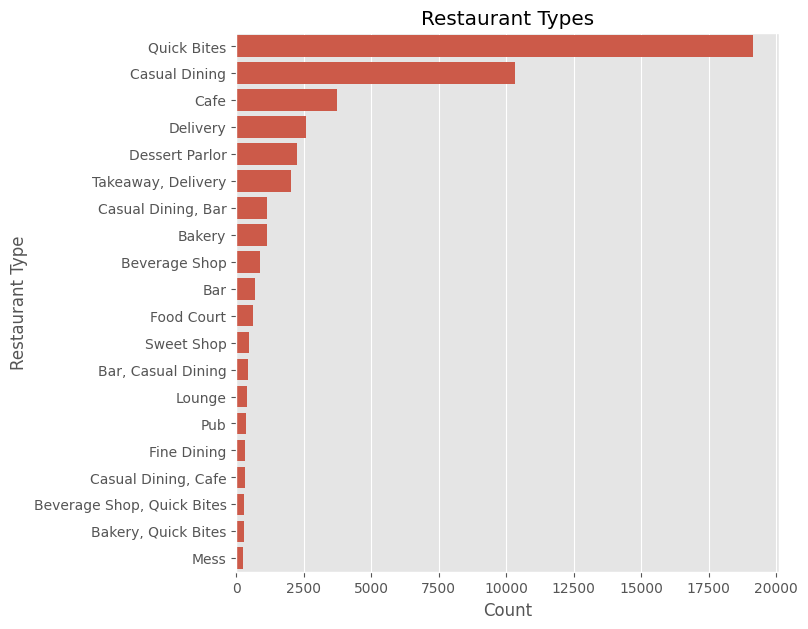

In [ ]:
# matplotlib.pyplot, which is used for creating plots and also for visualizations
import matplotlib.pyplot as plt

# it imports the Seaborn library and which is also used for making statistical graphics and visualizations
import seaborn as sns

# creates a new figure for your plot,and specifies that the figure should be 7 inches wide and 7 inches high and it will creating a square-ish plot
plt.figure(figsize=(7, 7))

# line counts the occurrences of each restaurant type in the 'rest_type' column of the DataFrame and stores the top 20 most frequent types in the rest variable as shown in the plot
rest = df['rest_type'].value_counts()[:20]

# line creates a bar plot with Seaborn plot,and the x-axis shows the counts of the top 20 restaurant types, and the y-axis lists the names of those restaurant types. 
sns.barplot(x=rest.values, y=rest.index) 

# it will sets the title for the plot to "Restaurant Types"
plt.title("Restaurant Types")

# Sets the label for the x-axis to "Count"
plt.xlabel("Count")

# Sets the label for the y-axis to "Restaurant Type" and the lines add descriptive labels to the plot
plt.ylabel("Restaurant Type")

# the line displays the plot that we created
plt.show()

In [ ]:
# line creates a variable named trace0,in Plotly a "trace" is a way to represent a specific set of data visually or like a box plot or line graph 
trace0=go.Box(y=df['approx_cost(for two people)'],name="accepting online orders",
              marker = dict(
        color = 'rgb(214, 12, 140)',
    ))

# creates a list containing the box plot trace as we said already
data=[trace0]

# line creates a layout object for the plot, setting up the title, width, height, and the title for the y-axis
layout=go.Layout(title="Box plot of approximate cost",width=800,height=500,yaxis=dict(title="Price"))

# this line combines the data of the box plot trace and the layout of the plot's appearance into a single figure object
fig=go.Figure(data=data,layout=layout)

# line displays the Plotly figure that we created
py.iplot(fig)

In [ ]:
# creates a new data frame called cost_dist by selecting specific columns from the original df data frame and removing any rows that contain missing values in those columns
cost_dist=df[['rate','approx_cost(for two people)','location','name','rest_type']].dropna()

#  line cleans and converts the 'rate' column to numerical ratings, extracting the part before the slash if the format is correct, otherwise assigning 0 for invalid entries
cost_dist['rate']=cost_dist['rate'].apply(lambda x: float(x.split('/')[0]) if len(x)>3 else 0)

# line removes commas from the 'approx_cost(for two people)' column and converts the values to integers for easier calculations
cost_dist['approx_cost(for two people)']=cost_dist['approx_cost(for two people)'].apply(lambda x: int(x.replace(',','')))

In [ ]:
# the line defines a function named return_budget which takes the two parameters,location (the restaurant's location) and rest (the type of restaurant)
def return_budget(location,rest):
    
    #  the cost_dist dataframe to create a new DataFrame called budget, and also containing rows where the approximate cost is ≤ 400, the location matches the input, and the rating is > 4, and the restaurant type matches the input
    budget=cost_dist[(cost_dist['approx_cost(for two people)']<=400) & (cost_dist['location']==location) & 
                     (cost_dist['rate']>4) & (cost_dist['rest_type']==rest)]
    
    # it returns an array of unique restaurant names from the filtered budget DataFrame which meet all specified criterias
    return(budget['name'].unique())

In [ ]:
# line calls the return_budget function to find restaurants in "BTM" that are "Quick Bites" and meet the budget and rating criteria defined within the function and also returning a list of their unique names
return_budget('BTM',"Quick Bites")

array(['Swadista Aahar', 'Litti Twist', 'The Shawarma Shop', 'Gorbandh',
       'Yum In My Tum', 'Chaatimes', "Muthashy's", 'Swad Punjab Da',
       "Domino's Pizza", 'Roti Wala', 'Andhra Kitchen'], dtype=object)

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_16496\2380860956.py:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




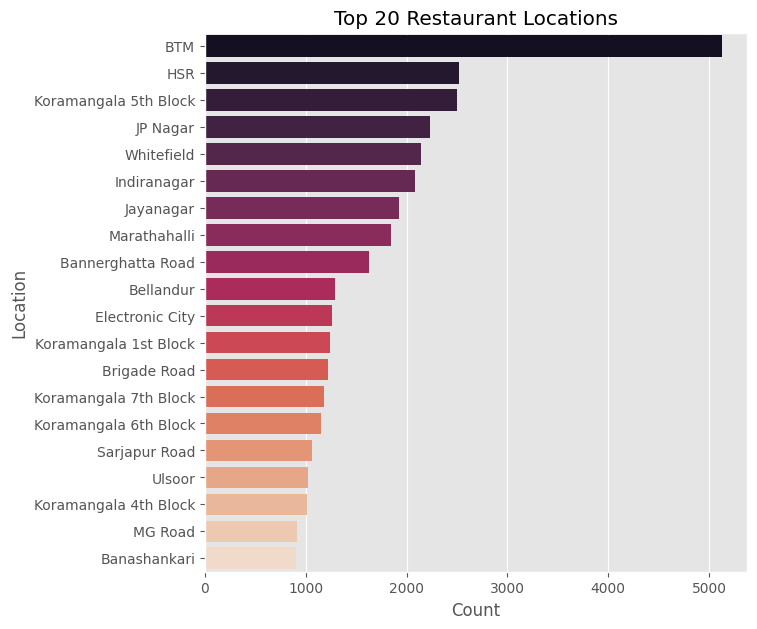

In [ ]:
# matplotlib.pyplot, which is used for creating plots and also for visualizations
import matplotlib.pyplot as plt

# it imports the Seaborn library and which is also used for making statistical graphics and visualizations
import seaborn as sns

# it Creates a new figure for plotting with a size of 7 inches by 7 inches and also ensuring that the plot will have a square shape
plt.figure(figsize=(7, 7))

# the line counts the occurrences of each unique value in the 'location' column of the DataFrame and sorts them in descending order and selects the top 20 locations and the result is stored in the variable Rest_locations.
Rest_locations = df['location'].value_counts()[:20]

# the line creates a horizontal bar plot using Seaborn ,which the x parameter is set to the counts of restaurant locations (Rest_locations.values), and the y parameter is set to the names of those locations (Rest_locations.index) and The palette="rocket" specifies a color palette for the bars
sns.barplot(x=Rest_locations.values, y=Rest_locations.index, palette="rocket")  

# the line sets the title of the plot to "Top 20 Restaurant Locations".
plt.title("Top 20 Restaurant Locations")

# the x-axis label as "Count", which indicating that it represents the number of restaurants at each location
plt.xlabel("Count")

# the y-axis label as "Location", which indicating that it represents different restaurant locations
plt.ylabel("Location")

# later all it displays the plot
plt.show()


In [ ]:
# the line groups the df by 'location' and 'cuisines',and counts the occurrences for each combination, and stores the result in a new DataFrame called df_1
df_1=df.groupby(['location','cuisines']).agg('count')

# this line counts cuisines per location and finds the top 3 cuisines per location by count and also stores the counts in 'count' column
data=df_1.sort_values(['url'],ascending=False).groupby(['location'],
                as_index=False).apply(lambda x : x.sort_values(by="url",ascending=False).head(3))['url'].reset_index().rename(columns={'url':'count'})


In [ ]:
# displays the first 10 rows of the dataframe data and also quickly view a sample of the data 
data.head(10)

,level_0,location,cuisines,count
0,0,BTM,"North Indian, Chinese",379
1,0,BTM,North Indian,340
2,0,BTM,Biryani,120
3,1,Banashankari,South Indian,86
4,1,Banashankari,"North Indian, Chinese",61
5,1,Banashankari,North Indian,36
6,2,Banaswadi,South Indian,37
7,2,Banaswadi,"North Indian, Chinese",24
8,2,Banaswadi,Biryani,23
9,3,Bannerghatta Road,"North Indian, Chinese",130


In [ ]:
import pandas as pd
import numpy as np
import time
from geopy.geocoders import Nominatim


locations = pd.DataFrame({"Name": df['location'].unique()})
locations['Name'] = locations['Name'].apply(lambda x: "Bangalore " + str(x))


geolocator = Nominatim(user_agent="app", timeout=10)

lat_lon = []

for location in locations['Name']:
    try:
        location_data = geolocator.geocode(location)
        if location_data is None:
            lat_lon.append(np.nan)
        else:
            lat_lon.append((location_data.latitude, location_data.longitude))
        
        
        time.sleep(1.5)  
    
    except Exception as e:
        print(f"Error with location {location}: {e}")
        lat_lon.append(np.nan)

locations['geo_loc'] = lat_lon
locations.to_csv('locations.csv', index=False)


In [ ]:
# line cleans the "Name" column by removing "Bangalore" 
locations["Name"]=locations['Name'].apply(lambda x :  x.replace("Bangalore","")[1:])

# the line displays the first 5 rows of the locations
locations.head()

,Name,geo_loc
0,Banashankari,"(12.9393328, 77.5539819)"
1,Basavanagudi,"(12.9417261, 77.5755021)"
2,Mysore Road,"(12.910349054405915, 77.48232502068171)"
3,Jayanagar,"(12.9399039, 77.5826382)"
4,Kumaraswamy Layout,"(12.9067683, 77.5595021)"


In [ ]:
# this line counts the locations in df, and converts it to dataframe Rest_locations with columns for location names and their counts
Rest_locations=pd.DataFrame(df['location'].value_counts().reset_index())

# line assigns the names to the columns of the Rest_locations in the DataFrame
Rest_locations.columns=['Name','count']

# this line merges the Rest_locations with another DataFrame called locations based on the common column name
Rest_locations=Rest_locations.merge(locations,on='Name',how="left").dropna()

# this line  selects the 'count' column from the Rest_locations DataFrame and also calculates the maximum value in the 'count' column
Rest_locations['count'].max()

5124

In [ ]:
# this line creates a basic map using the folium library and also sets the default values
def generateBaseMap(default_location=[12.97, 77.59], default_zoom_start=12):
    
    # line creates a folium.Map object that represents the map, centers it at the coordinates specified in default_location, adds a scale bar for distance estimation, and sets the initial zoom level based on the value provided in default_zoom_start
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    # this line returns the basemap
    return base_map

In [ ]:
lat,lon=zip(*np.array(Rest_locations['geo_loc']))
Rest_locations['lat']=lat
Rest_locations['lon']=lon
basemap=generateBaseMap()
HeatMap(Rest_locations[['lat','lon','count']].values.tolist(),zoom=20,radius=15).add_to(basemap)

In [ ]:
basemap

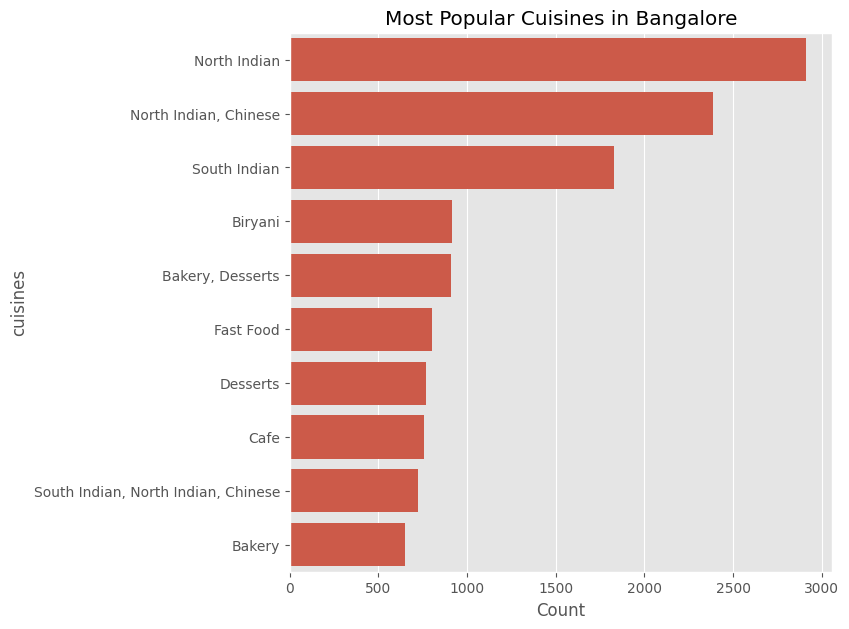

In [ ]:
# matplotlib.pyplot, which is used for creating plots and also for visualizations
import matplotlib.pyplot as plt

# it imports the Seaborn library and which is also used for making statistical graphics and visualizations
import seaborn as sns

# it Creates a new figure for plotting with a size of 7 inches by 7 inches and also ensuring that the plot will have a square shape
plt.figure(figsize=(7, 7))

# line is extracting the 'cuisines' column from a dataframe named df and counts that how many times each unique cuisine appears in the column and in the it only selects the top most 10 cuisine
cuisines = df['cuisines'].value_counts()[:10]

# line uses the Seaborn library to create a bar plot and x=cuisines.values argument specifies that the counts of the cuisines will be plotted on the x-axis and cuisine index plotted on the y-axis
sns.barplot(x=cuisines.values, y=cuisines.index)  

#  line labels the x-axis of the plot with the "Count"
plt.xlabel('Count')

# line sets the title of the plot to "Most Popular Cuisines in Bangalore" and it gives context to the user about what the plot represents
plt.title("Most Popular Cuisines in Bangalore")

# it displays the plot
plt.show()


In [ ]:
def produce_data(col,name):
    data= pd.DataFrame(df[df[col]==name].groupby(['location'],as_index=False)['url'].agg('count'))
    data.columns=['Name','count']
    print(data.head())
    data=data.merge(locations,on="Name",how='left').dropna()
    data['lan'],data['lon']=zip(*data['geo_loc'].values)
    return data.drop(['geo_loc'],axis=1)


In [ ]:
North_India=produce_data('cuisines','North Indian')

                Name  count
0                BTM    340
1       Banashankari     36
2          Banaswadi     12
3  Bannerghatta Road     75
4       Basavanagudi     21


In [ ]:
basemap=generateBaseMap()
HeatMap(North_India[['lan','lon','count']].values.tolist(),zoom=20,radius=15).add_to(basemap)
basemap

In [ ]:
food=produce_data('cuisines','South Indian')
basemap=generateBaseMap()
HeatMap(food[['lan','lon','count']].values.tolist(),zoom=20,radius=15).add_to(basemap)
basemap

                Name  count
0                BTM    113
1       Banashankari     86
2          Banaswadi     37
3  Bannerghatta Road     48
4       Basavanagudi     89


In [ ]:
def produce_chains(name):
    data_chain=pd.DataFrame(df[df["name"]==name]['location'].value_counts().reset_index())
    data_chain.columns=['Name','count']
    data_chain=data_chain.merge(locations,on="Name",how="left").dropna()
    data_chain['lan'],data_chain['lon']=zip(*data_chain['geo_loc'].values)
    return data_chain[['Name','count','lan','lon']]


In [ ]:
df_1=df.groupby(['rest_type','name']).agg('count')
datas=df_1.sort_values(['url'],ascending=False).groupby(['rest_type'],
                as_index=False).apply(lambda x : x.sort_values(by="url",ascending=False).head(3))['url'].reset_index().rename(columns={'url':'count'})


In [ ]:
mapbox_access_token="pk.eyJ1Ijoic2hhaHVsZXMiLCJhIjoiY2p4ZTE5NGloMDc2YjNyczBhcDBnZnA5aCJ9.psBECQ2nub0o25PgHcU88w"


In [ ]:
casual=datas[datas['rest_type']=='Casual Dining']
casual

,level_0,rest_type,name,count
59,27,Casual Dining,Empire Restaurant,58
60,27,Casual Dining,Beijing Bites,48
61,27,Casual Dining,Mani's Dum Biryani,47


In [ ]:
def produce_trace(data_chain,name):
        data_chain['text']=data_chain['Name']+'<br>'+data_chain['count'].astype(str)
        trace =  go.Scattermapbox(
           
                lat=data_chain['lan'],
                lon=data_chain['lon'],
                mode='markers',
                marker=go.scattermapbox.Marker(
                    size=data_chain['count']*4
                ),
                text=data_chain['text'],name=name
            )
        
        return trace

In [ ]:
data=[] 
for row in casual['name']:
    data_chain=produce_chains(row) 
    trace_0=produce_trace(data_chain,row)
    data.append(trace_0)



layout = go.Layout(title="Casual Dining Restaurant chains locations around Banglore",
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,style="streets",
        center=dict(
            lat=12.96,
            lon=77.59
        ),
        pitch=0,
        zoom=10
    ),
)


fig = dict(data=data, layout=layout)
py.iplot(fig, filename='Montreal Mapbox')

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\592674063.py:3: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\592674063.py:3: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\592674063.py:3: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



In [ ]:
quick=datas[datas['rest_type']=='Quick Bites']
quick 

,level_0,rest_type,name,count
179,78,Quick Bites,Five Star Chicken,69
180,78,Quick Bites,Domino's Pizza,60
181,78,Quick Bites,McDonald's,59


In [ ]:
data=[]  
for row in quick['name']:
    data_chain=produce_chains(row) 
    trace_0=produce_trace(data_chain,row)
    data.append(trace_0)



layout = go.Layout(title="Quick Bites Restaurant chains locations around Banglore",
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,style="streets",
        center=dict(
            lat=12.96,
            lon=77.59
        ),
        pitch=0,
        zoom=10
    ),
)


fig = dict(data=data, layout=layout)
py.iplot(fig, filename='Montreal Mapbox')

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\592674063.py:3: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\592674063.py:3: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\592674063.py:3: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



In [ ]:
cafe=datas[datas['rest_type']=='Cafe']
cafe

,level_0,rest_type,name,count
41,19,Cafe,Cafe Coffee Day,96
42,19,Cafe,Smally's Resto Cafe,54
43,19,Cafe,Mudpipe Cafe,39


In [ ]:
data=[]  
for row in cafe['name']:
    data_chain=produce_chains(row) 
    trace_0=produce_trace(data_chain,row)
    data.append(trace_0)



layout = go.Layout(title="Cafe Restaurant chains locations around Banglore",
    autosize=True,
    hovermode='closest',
    mapbox=dict(
        accesstoken=mapbox_access_token,
        bearing=0,style="streets",
        center=dict(
            lat=12.96,
            lon=77.59
        ),
        pitch=0,
        zoom=10
    ),
)


fig = dict(data=data, layout=layout)
py.iplot(fig, filename='Montreal Mapbox')

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\592674063.py:3: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\592674063.py:3: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\592674063.py:3: DeprecationWarning:

*scattermapbox* is deprecated! Use *scattermap* instead. Learn more at: https://plotly.com/python/mapbox-to-maplibre/



In [ ]:
df['dish_liked']=df['dish_liked'].apply(lambda x : x.split(',') if type(x)==str else [''])

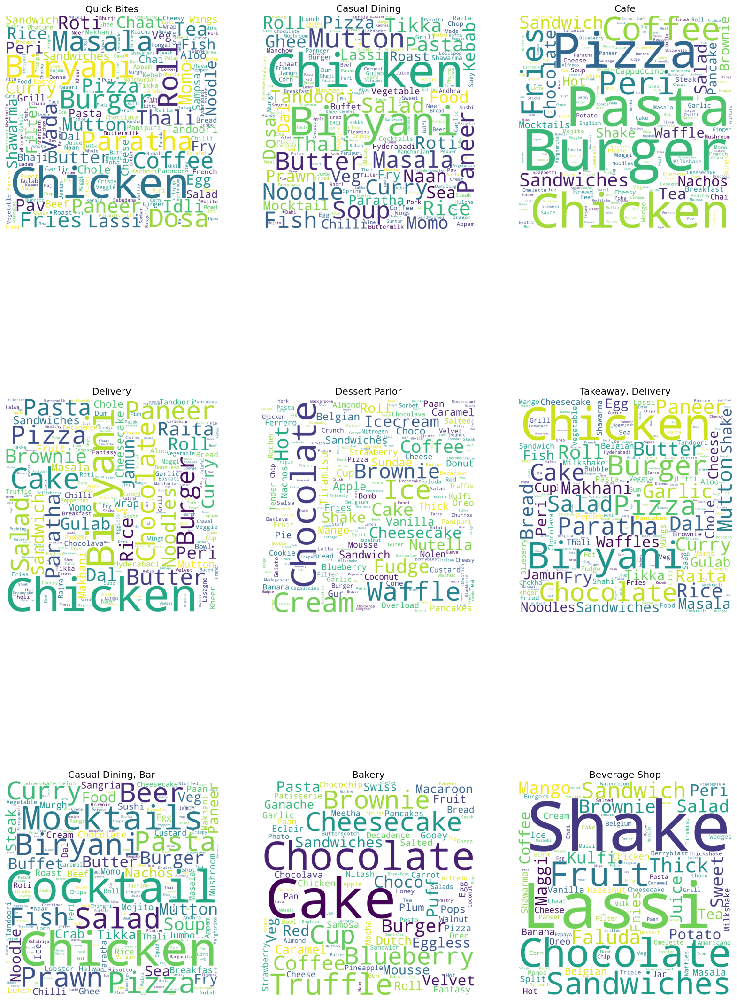

In [ ]:
rest=df['rest_type'].value_counts()[:9].index
def produce_wordcloud(rest):
    
    plt.figure(figsize=(20,30))
    for i,r in enumerate(rest):
        plt.subplot(3,3,i+1)
        corpus=df[df['rest_type']==r]['dish_liked'].values.tolist()
        corpus=','.join(x  for list_words in corpus for x in list_words)
        wordcloud = WordCloud(max_font_size=None, background_color='white', collocations=False,
                      width=1500, height=1500).generate(corpus)
        plt.imshow(wordcloud)
        plt.title(r)
        plt.axis("off")
        

        
        
produce_wordcloud(rest)

In [ ]:
all_ratings = []

for name,ratings in tqdm(zip(df['name'],df['reviews_list'])):
    ratings = eval(ratings)
    for score, doc in ratings:
        if score:
            score = score.strip("Rated").strip()
            doc = doc.strip('RATED').strip()
            score = float(score)
            all_ratings.append([name,score, doc])

51717it [00:15, 3252.74it/s]


In [ ]:
rating_df=pd.DataFrame(all_ratings,columns=['name','rating','review'])
rating_df['review']=rating_df['review'].apply(lambda x : re.sub('[^a-zA-Z0-9\s]',"",x))


<>:2: SyntaxWarning:

invalid escape sequence '\s'

<>:2: SyntaxWarning:

invalid escape sequence '\s'

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\1849998619.py:2: SyntaxWarning:

invalid escape sequence '\s'



In [ ]:
# It takes all the data in rating_df ,and saves it into a file
rating_df.to_csv("Ratings.csv")

In [ ]:
# display the first few rows of a DataFrame named 
rating_df.head()

,name,rating,review
0,Jalsa,4.0,A beautiful place to dine inThe interiors take...
1,Jalsa,4.0,I was here for dinner with my family on a week...
2,Jalsa,2.0,Its a restaurant near to Banashankari BDA Me a...
3,Jalsa,4.0,We went here on a weekend and one of us had th...
4,Jalsa,5.0,The best thing about the place is its ambiance...


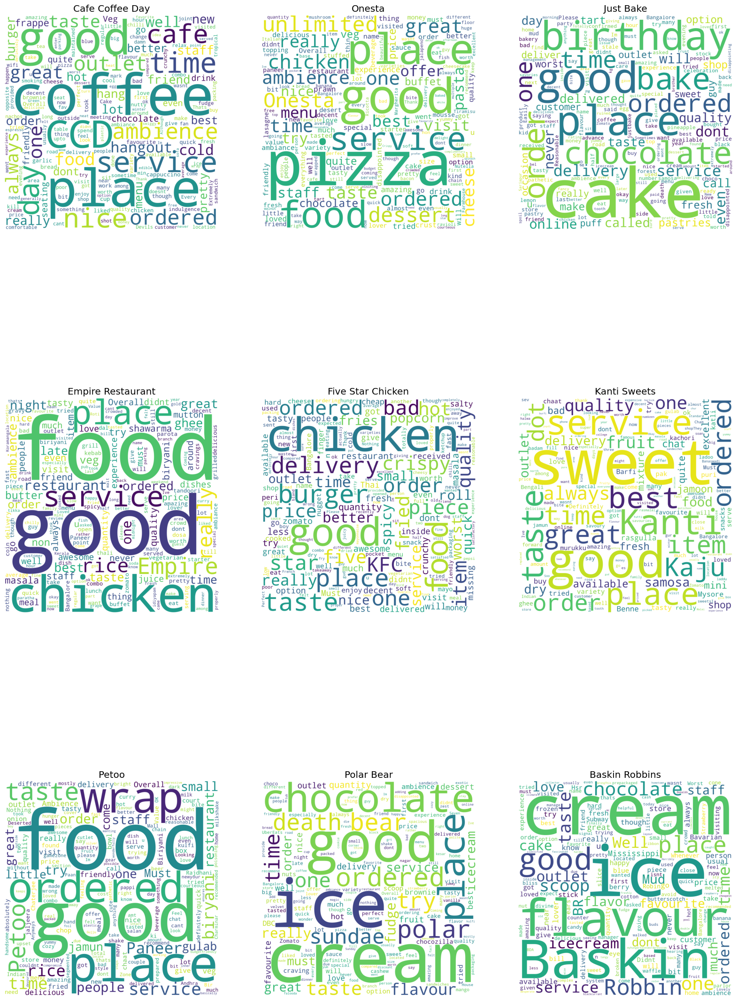

In [ ]:
rest=df['name'].value_counts()[:9].index
def produce_wordcloud(rest):
    
    plt.figure(figsize=(20,30))
    for i,r in enumerate(rest):
        plt.subplot(3,3,i+1)
        corpus=rating_df[rating_df['name']==r]['review'].values.tolist()
        corpus=' '.join(x  for x in corpus)
        wordcloud = WordCloud(max_font_size=None, background_color='white', collocations=False,
                      width=1500, height=1500).generate(corpus)
        plt.imshow(wordcloud)
        plt.title(r)
        plt.axis("off")
        

        
        
produce_wordcloud(rest)

Text(0, 0.5, 'count')

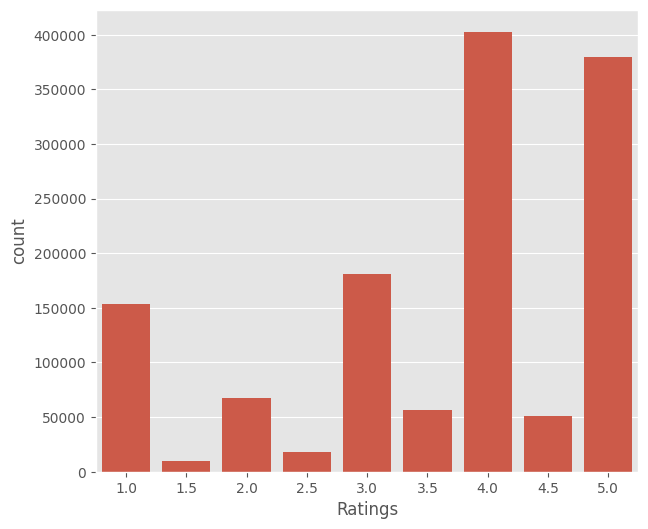

In [ ]:
# 
plt.figure(figsize=(7,6))

# 
rating=rating_df['rating'].value_counts()

# 
sns.barplot(x=rating.index,y=rating)

# 
plt.xlabel("Ratings")

# 
plt.ylabel('count')

In [ ]:
rating_df['sent']=rating_df['rating'].apply(lambda x: 1 if int(x)>2.5 else 0)

In [ ]:
import nltk
from nltk.corpus import stopwords
nltk.download('stopwords')
stop_words = set(stopwords.words('english'))
print(stop_words) 

{'the', 'more', 'were', "shan't", 'hadn', 'itself', 'about', 'then', 'once', 'has', 'd', 'themselves', 'nor', 'just', 're', 'on', 'they', 'which', 'won', 'for', 'how', 'so', "mustn't", 'no', 'y', 'those', "hasn't", 've', 'ain', 'that', 'yourself', 'and', 'will', 'all', 'you', 'into', "wouldn't", 'wasn', 'down', 'your', 'our', 'their', 'against', 'above', 'its', 'there', 'such', 'couldn', 'hers', 'me', 'yourselves', 'he', "she's", 'herself', 'when', 'been', "mightn't", 'each', 'wouldn', 'why', 'being', 'haven', 'doing', "didn't", 'or', 'in', 'very', 'isn', 'by', 'weren', 'here', 'over', "aren't", 'what', 'if', 'whom', 'is', 's', 'before', 'than', 'ourselves', 'yours', 'his', "haven't", 'few', "weren't", 'with', 'while', 'through', 'where', 'himself', 'these', 'after', 'too', 'off', 'some', 'a', 'but', 'm', "should've", 'my', "won't", 'from', 'am', 'under', "shouldn't", 'i', "hadn't", 'ma', 'further', 'needn', 'same', 'ours', 'didn', 'below', "that'll", "doesn't", "you're", 'him', 'most'

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\MOULYA\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [ ]:
import nltk
nltk.download('punkt')


[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\MOULYA\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


True

In [ ]:
stops=stopwords.words('english')
lem=WordNetLemmatizer()
corpus=' '.join(lem.lemmatize(x) for x in rating_df[rating_df['sent']==1]['review'][:3000] if x not in stops)
tokens=word_tokenize(corpus)

In [ ]:
vect=TfidfVectorizer()
vect_fit=vect.fit(tokens)

In [ ]:
from sklearn.feature_extraction.text import TfidfVectorizer
import gensim
tokens = ["this is a sample text", "text mining is interesting", "sample example of text processing"]
vect = TfidfVectorizer()
vectorized_data = vect.fit_transform(tokens)  
id_map = {v: k for k, v in vect.vocabulary_.items()} 
gensim_corpus = gensim.matutils.Sparse2Corpus(vectorized_data, documents_columns=False)
ldamodel = gensim.models.LdaModel(
    corpus=gensim_corpus,
    id2word=id_map,
    num_topics=5,
    random_state=34,
    passes=25
)




In [ ]:
counter=Counter(corpus)

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\3720450275.py:21: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\3720450275.py:21: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\3720450275.py:21: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\3720450275.py:21: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



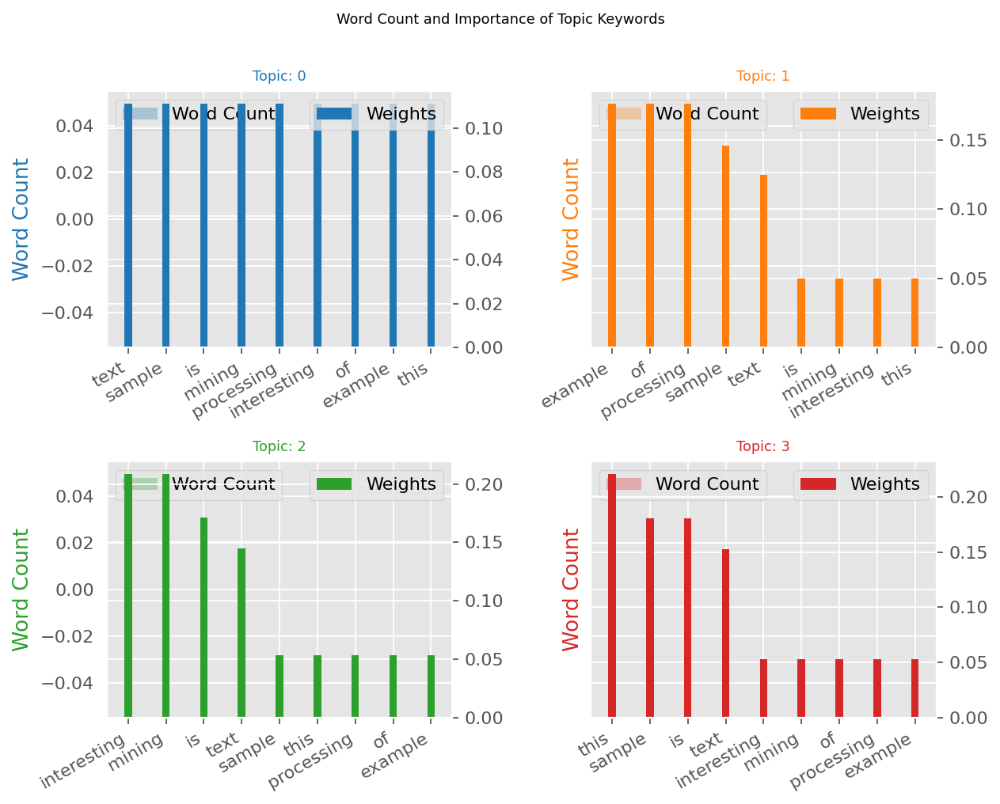

In [ ]:
out=[]
topics=ldamodel.show_topics(formatted=False)
for i,topic in topics:
    for word,weight in topic:
        out.append([word,i,weight,counter[word]])
dataframe = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        
fig, axes = plt.subplots(2, 2, figsize=(8,6), sharey=True, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=dataframe.loc[dataframe.topic_id==i, :], color=cols[i], width=0.3, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=dataframe.loc[dataframe.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=8)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(dataframe.loc[dataframe.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')
fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=8, y=1.05)    
plt.show()

In [ ]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')  
stops = set(stopwords.words('english'))  
lem = WordNetLemmatizer()
corpus = ' '.join(lem.lemmatize(word) 
                  for review in rating_df[rating_df['sent'] == 0]['review'][:3000] 
                  for word in word_tokenize(review.lower()) 
                  if word.isalnum() and word not in stops)  
tokens = word_tokenize(corpus)
print(tokens[:50]) 
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('punkt')  
stops = set(stopwords.words('english'))  
lem = WordNetLemmatizer()
corpus = ' '.join(lem.lemmatize(word) 
                  for review in rating_df[rating_df['sent'] == 0]['review'][:3000] 
                  for word in word_tokenize(review.lower())  
                  if word.isalnum() and word not in stops)  
tokens = word_tokenize(corpus)
print(tokens[:50])  


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\MOULYA\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\MOULYA\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\MOULYA\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


['restaurant', 'near', 'banashankari', 'bda', 'along', 'office', 'friend', 'visited', 'buffet', 'unfortunately', 'provide', 'veg', 'buffet', 'inquiring', 'said', 'place', 'mostly', 'visited', 'vegetarian', 'anyways', 'ordered', 'ala', 'carte', 'item', 'took', 'age', 'come', 'food', 'ok', 'ok', 'definitely', 'visiting', 'anymore', 'bad', 'experience', 'dont', 'know', 'la', 'carte', 'buffet', 'worst', 'gave', 'u', 'complementary', 'drink', 'momos', 'buffet', 'momos', 'really', 'good']


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\MOULYA\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\MOULYA\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\MOULYA\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!


['restaurant', 'near', 'banashankari', 'bda', 'along', 'office', 'friend', 'visited', 'buffet', 'unfortunately', 'provide', 'veg', 'buffet', 'inquiring', 'said', 'place', 'mostly', 'visited', 'vegetarian', 'anyways', 'ordered', 'ala', 'carte', 'item', 'took', 'age', 'come', 'food', 'ok', 'ok', 'definitely', 'visiting', 'anymore', 'bad', 'experience', 'dont', 'know', 'la', 'carte', 'buffet', 'worst', 'gave', 'u', 'complementary', 'drink', 'momos', 'buffet', 'momos', 'really', 'good']


In [ ]:
vect=TfidfVectorizer()
vect_fit=vect.fit(tokens)
id_map=dict((v,k) for k,v in vect.vocabulary_.items())
vectorized_data=vect_fit.transform(tokens)
gensim_corpus=gensim.matutils.Sparse2Corpus(vectorized_data,documents_columns=False)
ldamodel = gensim.models.ldamodel.LdaModel(gensim_corpus,id2word=id_map,num_topics=5,random_state=34,passes=25)


C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\1144069009.py:22: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\1144069009.py:22: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\1144069009.py:22: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.

C:\Users\MOULYA\AppData\Local\Temp\ipykernel_21912\1144069009.py:22: UserWarning:

set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.



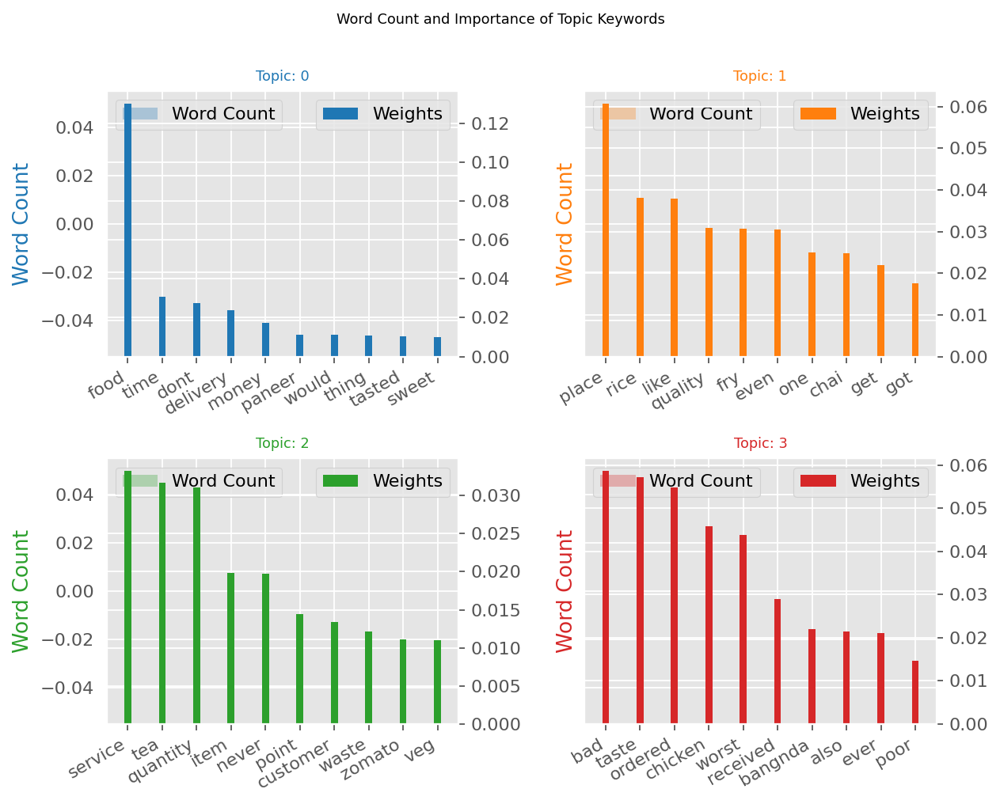

In [ ]:
counter=Counter(corpus)
out=[]
topics=ldamodel.show_topics(formatted=False)
for i,topic in topics:
    for word,weight in topic:
        out.append([word,i,weight,counter[word]])

dataframe = pd.DataFrame(out, columns=['word', 'topic_id', 'importance', 'word_count'])        



fig, axes = plt.subplots(2, 2, figsize=(8,6), sharey=True, dpi=160)
cols = [color for name, color in mcolors.TABLEAU_COLORS.items()]
for i, ax in enumerate(axes.flatten()):
    ax.bar(x='word', height="word_count", data=dataframe.loc[dataframe.topic_id==i, :], color=cols[i], width=0.3, alpha=0.3, label='Word Count')
    ax_twin = ax.twinx()
    ax_twin.bar(x='word', height="importance", data=dataframe.loc[dataframe.topic_id==i, :], color=cols[i], width=0.2, label='Weights')
    ax.set_ylabel('Word Count', color=cols[i])
    
    ax.set_title('Topic: ' + str(i), color=cols[i], fontsize=8)
    ax.tick_params(axis='y', left=False)
    ax.set_xticklabels(dataframe.loc[dataframe.topic_id==i, 'word'], rotation=30, horizontalalignment= 'right')
    ax.legend(loc='upper left'); ax_twin.legend(loc='upper right')

fig.tight_layout(w_pad=2)    
fig.suptitle('Word Count and Importance of Topic Keywords', fontsize=8, y=1.05)    
plt.show()

In [ ]:
from gensim.models import Word2Vec

model = Word2Vec(corpus, vector_size=100, window=20, min_count=200, workers=4)


In [ ]:
def tsne_plot(model):
    "Creates and TSNE model and plots it"
    labels = []
    tokens = []

    for word in model.wv.vocab:
        tokens.append(model[word])
        labels.append(word)
    
    tsne_model = TSNE(perplexity=40, n_components=2, init='pca', n_iter=2500, random_state=23)
    new_values = tsne_model.fit_transform(tokens)

    x = []
    y = []
    for value in new_values:
        x.append(value[0])
        y.append(value[1])
        
    plt.figure(figsize=(10, 10)) 
    for i in range(len(x)):
        plt.scatter(x[i],y[i])
        plt.annotate(labels[i],
                     xy=(x[i], y[i]),
                     xytext=(5, 2),
                     textcoords='offset points',
                     ha='right',
                     va='bottom')
    plt.show()

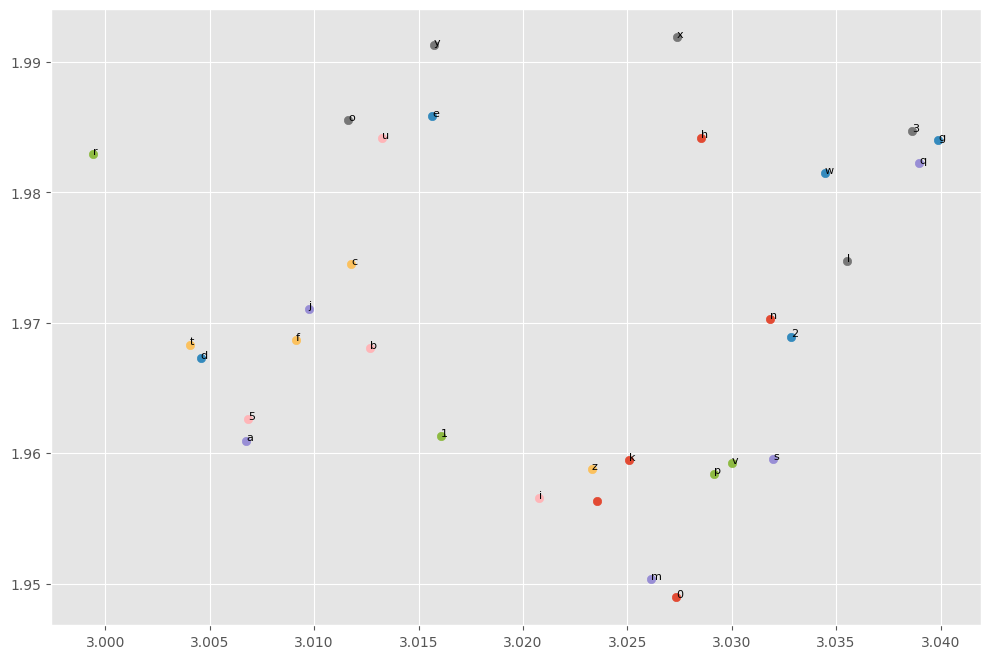

In [ ]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
import numpy as np

def tsne_plot(model):
    labels = []
    tokens = []

    
    for word in model.wv.index_to_key:
        tokens.append(model.wv[word])
        labels.append(word)

    tokens = np.array(tokens)

    
    perplexity = min(40, len(tokens) - 1)  

    
    tsne_model = TSNE(n_components=2, random_state=42, perplexity=perplexity, n_iter=3000)
    reduced_tokens = tsne_model.fit_transform(tokens)

    
    plt.figure(figsize=(12, 8))
    for i, label in enumerate(labels):
        x, y = reduced_tokens[i, :]
        plt.scatter(x, y)
        plt.annotate(label, (x, y), fontsize=8)
    plt.show()


tsne_plot(model)


In [ ]:
postive=rating_df[rating_df['rating']>3]['review'][:2000]
negative=rating_df[rating_df['rating']<2.5]['review'][:2000]

def return_corpus(df):
    corpus=[]
    for review in df:
        tagged=nltk.pos_tag(word_tokenize(review))
        adj=[]
        for x in tagged:
            if x[1]=='JJ':
                adj.append(x[0])
        corpus.append(adj)
    return corpus

c:\Users\MOULYA\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\manifold\_t_sne.py:1164: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.



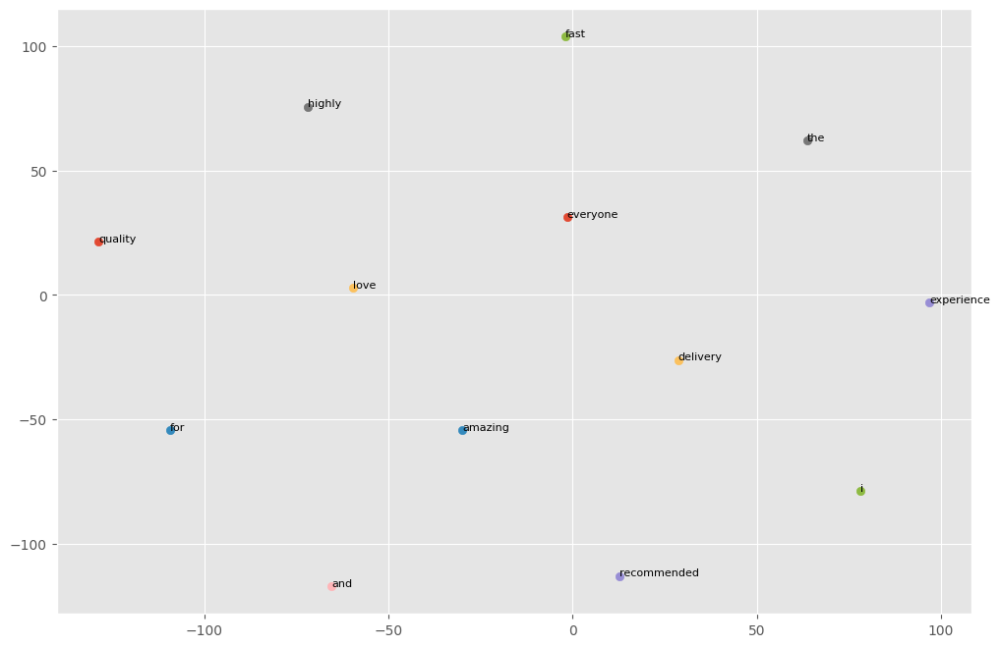

In [ ]:
from gensim.models import Word2Vec


positive = [
    "I love the experience",
    "Amazing quality and fast delivery",
    "Highly recommended for everyone"
]


def return_corpus(text_list):
    return [sentence.lower().split() for sentence in text_list] 
corpus = return_corpus(positive)


model = Word2Vec(vector_size=100, min_count=1, window=20, workers=4)


model.build_vocab(corpus)


model.train(corpus, total_examples=len(corpus), epochs=10)


tsne_plot(model)




Vocabulary size: 21


c:\Users\MOULYA\AppData\Local\Programs\Python\Python312\Lib\site-packages\sklearn\manifold\_t_sne.py:1164: FutureWarning:

'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.



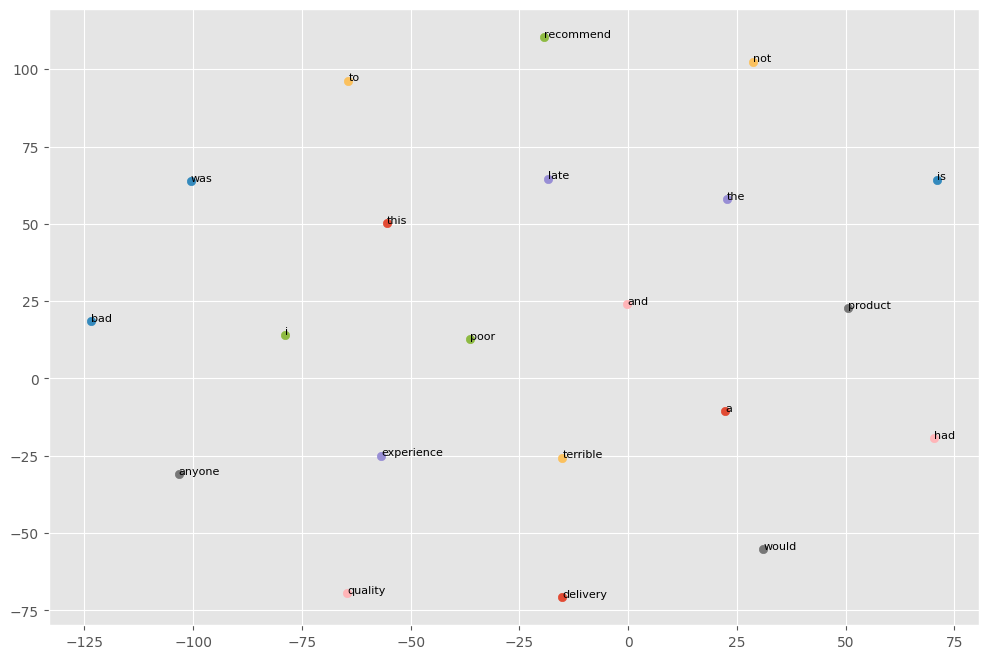

In [ ]:
from gensim.models import Word2Vec


negative = [
    "I had a bad experience",
    "The quality is poor and delivery was late",
    "Would not recommend this to anyone"
]


def return_corpus(text_list):
    return [sentence.lower().split() for sentence in text_list]  

corpus = return_corpus(negative)


model = Word2Vec(vector_size=100, min_count=1, window=20, workers=4)  


model.build_vocab(corpus)


print("Vocabulary size:", len(model.wv))


if len(model.wv) > 0:
    model.train(corpus, total_examples=len(corpus), epochs=10)
    
    tsne_plot(model)
else:
    print("Error: Vocabulary is empty. Try lowering min_count.")


In [ ]:
rating_df['sent']=rating_df['rating'].apply(lambda x: 1 if int(x)>2.5 else 0)

In [ ]:
max_features=3000
tokenizer=Tokenizer(num_words=max_features,split=' ')
tokenizer.fit_on_texts(rating_df['review'].values)
X = tokenizer.texts_to_sequences(rating_df['review'].values)
X = pad_sequences(X)

In [ ]:
embed_dim = 32
lstm_out = 32

model = Sequential()
model.add(Embedding(max_features, embed_dim,input_length = X.shape[1]))

model.add(LSTM(lstm_out, dropout=0.2, recurrent_dropout=0.2))
model.add(Dense(2,activation='softmax'))

model.compile(loss = 'categorical_crossentropy', optimizer='adam',metrics = ['accuracy'])
print(model.summary())

c:\Users\MOULYA\AppData\Local\Programs\Python\Python312\Lib\site-packages\keras\src\layers\core\embedding.py:90: UserWarning:

Argument `input_length` is deprecated. Just remove it.



Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ embedding (Embedding)           │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ lstm (LSTM)                     │ ?                      │   0 (unbuilt) │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense (Dense)                   │ ?                      │   0 (unbuilt) │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 0 (0.00 B)

 Trainable params: 0 (0.00 B)

 Non-trainable params: 0 (0.00 B)

None


In [ ]:
Y = pd.get_dummies(rating_df['sent'].astype(int)).values
X_train, X_test, Y_train, Y_test = train_test_split(X,Y, test_size = 0.33, random_state = 42)
print(X_train.shape,Y_train.shape)
print(X_test.shape,Y_test.shape)


(884378, 194) (884378, 2)
(435590, 194) (435590, 2)


In [ ]:
batch_size = 3200
model.fit(X_train, Y_train, epochs = 5, batch_size=batch_size)


Epoch 1/5
277/277 ━━━━━━━━━━━━━━━━━━━━ 255s 898ms/step - accuracy: 0.8569 - loss: 0.3468
Epoch 2/5
277/277 ━━━━━━━━━━━━━━━━━━━━ 250s 902ms/step - accuracy: 0.9406 - loss: 0.1536
Epoch 3/5
277/277 ━━━━━━━━━━━━━━━━━━━━ 250s 904ms/step - accuracy: 0.9490 - loss: 0.1318
Epoch 4/5
277/277 ━━━━━━━━━━━━━━━━━━━━ 227s 821ms/step - accuracy: 0.9548 - loss: 0.1186
Epoch 5/5
277/277 ━━━━━━━━━━━━━━━━━━━━ 224s 809ms/step - accuracy: 0.9596 - loss: 0.1072


In [ ]:
validation_size = 1500

X_validate = X_test[-validation_size:]
Y_validate = Y_test[-validation_size:]
X_test = X_test[:-validation_size]
Y_test = Y_test[:-validation_size]
score,acc = model.evaluate(X_test, Y_test, verbose = 2, batch_size = batch_size)
print("score: %.2f" % (score))
print("acc: %.2f" % (acc))

136/136 - 26s - 191ms/step - accuracy: 0.9632 - loss: 0.0991
score: 0.10
acc: 0.96
